# GIS-Based Traffic Simulation with Mesa
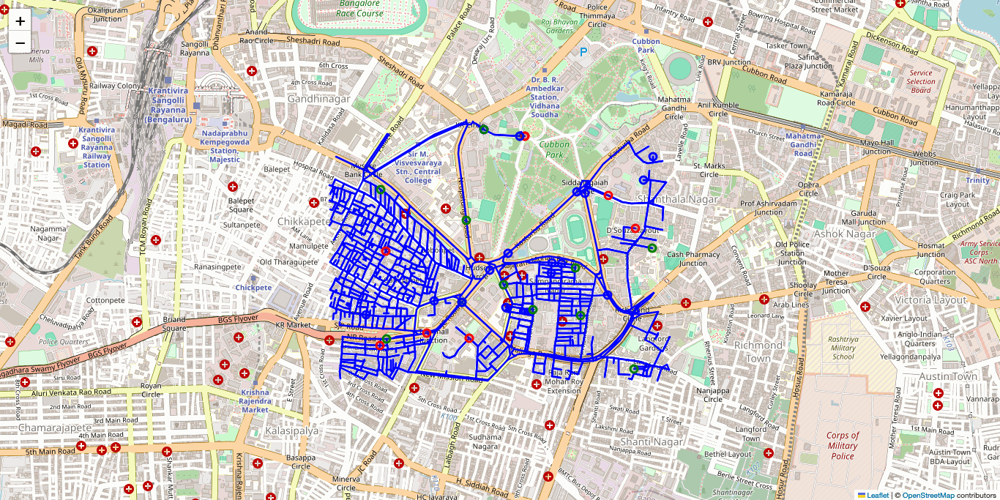

## Overview

This project is a GIS-based traffic simulation tool, built with Mesa, designed to model and visualize vehicle movements on real road networks. It aids urban planners and policymakers in understanding and optimizing traffic flow by simulating congestion and evaluating management strategies.

## Purpose

Visvalizing the flow of traffic simulating by Gif  


## Key Features

- **Real Road Networks** via OSMnx
- **Dynamic Traffic Simulation** of vehicle movements
- **Customizable Parameters** for tailored simulations

## Installation

- Python 3.x
- Mesa
- OSMnx
- NetworkX

## Usage

1. **Input Parameters:** Set vehicle count, start, and end points.
2. **Run Simulation:** Observe traffic flow and congestion.
3. **Analyze Results:** Review simulation outputs.

## How It Works

1. **Import Network:** Use OSMnx to load road data.
2. **Initialize Simulation:** Set up with Mesa and Mesa-Geo.
3. **Simulate Flow:** Vehicles move using NetworkX's shortest paths.



# Importing Libraries

- **Mesa**provide the foundation for building the agent-based model with geographic context.
- **GeoPandas** enables us to handle and manipulate geographic data easily, making it possible to integrate real-world maps and spatial data into our simulation.
- **Shapely** allows us to define and work with geometric shapes, which is crucial for positioning agents and defining their movement paths.
- **Random** helps in adding variability and realism to the simulation by introducing random elements, such as varying agent behaviors and routes.
- **PIL (Python Imaging Library)** provides image processing capabilities, allowing us to handle images within the simulation, such as loading and displaying maps or other visual elements.
- **io** enables in-memory operations, allowing us to work with image data without needing to save it to disk first.

By importing these libraries, we ensure that we have the necessary tools to build a robust and realistic GIS-based traffic simulation. Each library plays a vital role in different aspects of the project, from data handling and agent behavior to geographic visualization and image processing.

## Mesa is Playing a Main Role in This Model
Mesa provides a straightforward and efficient framework to create, manage, and simulate the movement of vehicles on a road network. It allows for the simple creation of agents (vehicles) that follow predefined paths, interact within a given space, and produce simulation results without unnecessary complexity.

**Mesa** is used because it enables you to build a functional and effective traffic simulation without overcomplicating the model. Its integration with other libraries like **OSMnx** and **NetworkX** ensures that the model remains easy to understand and maintain, focusing on delivering practical insights rather than adding complexity.

## Simulation with Road network 

/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_77762/3370846857.py:18: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  G = ox.graph_from_bbox(north, south, east, west, network_type='drive')


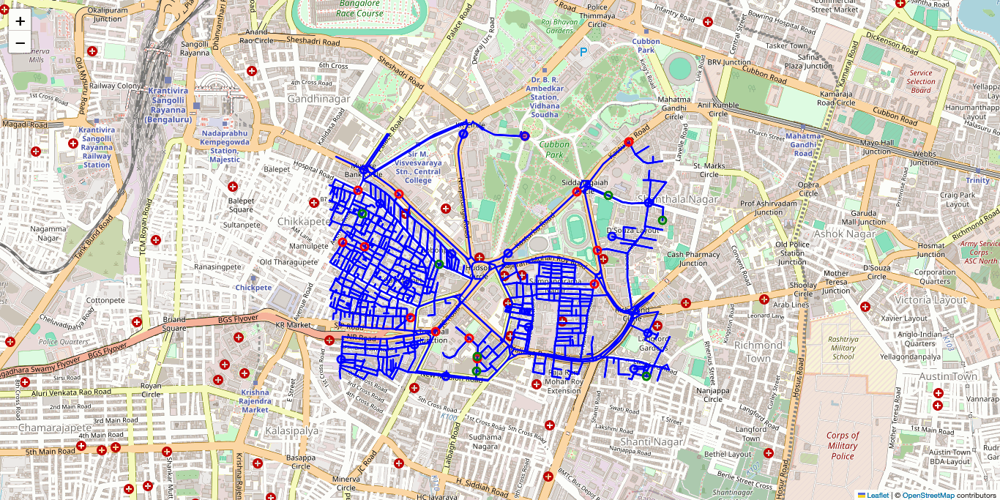

Simulation complete. Check the notebook for the Bangalore traffic congestion animation.


In [4]:
import os
import osmnx as ox
import networkx as nx
import folium
import random
import mesa
from mesa.space import ContinuousSpace
from shapely.geometry import Point
from PIL import Image
import io
from IPython.display import display, Image as IPImage

# Bounding box coordinates for Bangalore
north, south, east, west = 12.976, 12.961, 77.599, 77.579  # Adjusted coordinates for Bangalore

# Create a graph from the bounding box using the bbox parameter
bbox = (north, south, east, west)
G = ox.graph_from_bbox(north, south, east, west, network_type='drive')

# Extract graph bounds
min_x = min(nx.get_node_attributes(G, 'x').values())
max_x = max(nx.get_node_attributes(G, 'x').values())
min_y = min(nx.get_node_attributes(G, 'y').values())
max_y = max(nx.get_node_attributes(G, 'y').values())

# Define the TrafficGeoSpace class to integrate with the OSMnx graph
class TrafficGeoSpace(ContinuousSpace):
    def __init__(self, G, crs="EPSG:3857"):
        x_max = max_x - min_x
        y_max = max_y - min_y
        super().__init__(x_max, y_max, False)
        self.G = G  # Assign the OSMnx graph to the space
        self.crs = crs  # Coordinate Reference System

# Modify the VehicleAgent class to include a route, vehicle type, and current step in the route
class VehicleAgent(mesa.Agent):
    def __init__(self, unique_id, model, vehicle_type, route=None):
        super().__init__(unique_id, model)
        self.vehicle_type = vehicle_type  # Assign vehicle type (car, truck, bike)
        self.route = route  # Assign the route for the vehicle
        self.current_step = 0  # Initialize the current step in the route

    def step(self):
        if self.route and self.current_step < len(self.route):
            next_node = self.route[self.current_step]
            x = self.model.space.G.nodes[next_node]['x'] - min_x
            y = self.model.space.G.nodes[next_node]['y'] - min_y
            self.model.space.move_agent(self, (x, y))
            self.current_step += 1  # Move to the next step in the route
        else:
            pass  # Optionally, handle reaching the end of the route

# Modify the TrafficModel to use the road network from OSMnx
class TrafficModel(mesa.Model):
    def __init__(self, G, num_vehicles):
        super().__init__()
        self.schedule = mesa.time.RandomActivation(self)
        self.space = TrafficGeoSpace(G)
        self.create_vehicles(num_vehicles)

    def create_vehicles(self, num_vehicles):
        vehicle_types = ['car', 'truck', 'bike']
        for i in range(num_vehicles):
            start_point = (random.uniform(south, north), random.uniform(west, east))
            end_point = (random.uniform(south, north), random.uniform(west, east))
            start_node = ox.distance.nearest_nodes(self.space.G, X=start_point[1], Y=start_point[0])
            end_node = ox.distance.nearest_nodes(self.space.G, X=end_point[1], Y=end_point[0])

            try:
                route = nx.shortest_path(self.space.G, source=start_node, target=end_node, weight='length')
                vehicle_type = random.choice(vehicle_types)
                vehicle = VehicleAgent(i, self, vehicle_type=vehicle_type, route=route)
                start_position = (self.space.G.nodes[start_node]['x'] - min_x, self.space.G.nodes[start_node]['y'] - min_y)  # Adjust coordinates
                self.space.place_agent(vehicle, start_position)
                self.schedule.add(vehicle)
            except nx.NetworkXNoPath:
                pass  # Skip this vehicle if no route is found

    def step(self):
        self.schedule.step()

# Running the modified TrafficModel
num_vehicles = 51
model = TrafficModel(G, num_vehicles)

# Ensure the directory exists
gif_dir = 'Data/'
os.makedirs(gif_dir, exist_ok=True)

# Running the simulation and updating the Folium map
map_images = []
for _ in range(10):  # Run for 10 steps
    model.step()

    # Create a new map for each step
    temp_map = folium.Map(location=[(north + south) / 2, (east + west) / 2], zoom_start=15)
    
    # Add the road network to the map
    edges = ox.graph_to_gdfs(G, nodes=False, edges=True)
    for _, row in edges.iterrows():
        points = [(row['geometry'].coords[i][1], row['geometry'].coords[i][0]) for i in range(len(row['geometry'].coords))]
        folium.PolyLine(points, color='blue', weight=2.5, opacity=1).add_to(temp_map)

    # Add vehicles to the map
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            vehicle_position = (vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['y'],
                                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['x'])
            color = 'red' if vehicle.vehicle_type == 'car' else 'blue' if vehicle.vehicle_type == 'truck' else 'green'
            folium.CircleMarker(location=vehicle_position, radius=5, color=color, fill=True).add_to(temp_map)

    # Save the map state as an image
    img_data = temp_map._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    map_images.append(img)

# Create an animated GIF from the saved map images
gif_path = os.path.join(gif_dir, 'bangalore_traffic_congestion.gif')
map_images[0].save(gif_path, save_all=True, append_images=map_images[1:], duration=500, loop=0)

# Display the animated GIF in the notebook
display(IPImage(filename=gif_path))

print("Simulation complete. Check the notebook for the Bangalore traffic congestion animation.")


## Simulation without Road network 

/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_77762/2578363551.py:17: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  G = ox.graph_from_bbox(north, south, east, west, network_type='drive')


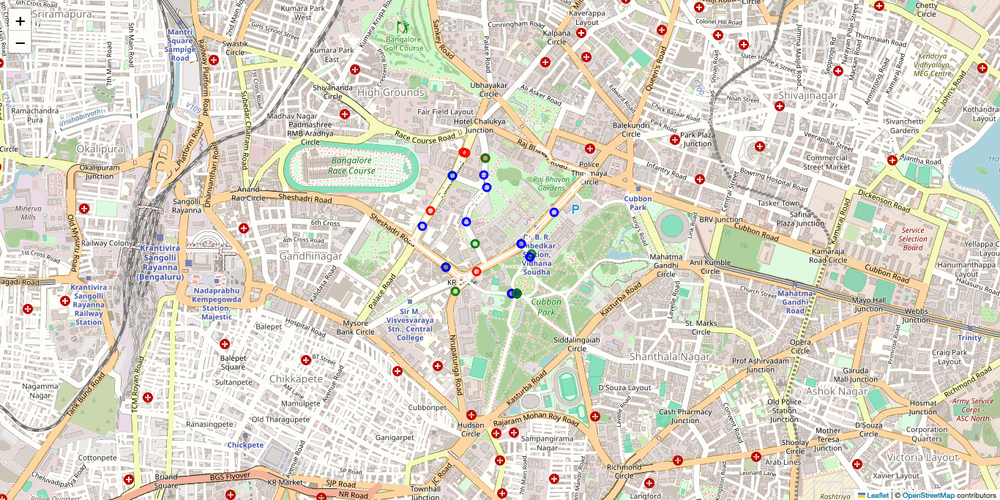

Simulation complete. Check the notebook for the traffic congestion animation.


In [7]:
import osmnx as ox
import networkx as nx
import folium
import random
import mesa
from mesa.space import ContinuousSpace
from shapely.geometry import Point
from PIL import Image
import io
from IPython.display import display, Image as IPImage

# Bounding box coordinates for a critical urban area in Bangalore
north, south, east, west = 12.984, 12.971, 77.595, 77.584

# Create a graph from the bounding box using the bbox parameter
bbox = (north, south, east, west)
G = ox.graph_from_bbox(north, south, east, west, network_type='drive')

# Extract graph bounds
min_x = min(nx.get_node_attributes(G, 'x').values())
max_x = max(nx.get_node_attributes(G, 'x').values())
min_y = min(nx.get_node_attributes(G, 'y').values())
max_y = max(nx.get_node_attributes(G, 'y').values())

# Define the TrafficGeoSpace class to integrate with the OSMnx graph
class TrafficGeoSpace(ContinuousSpace):
    def __init__(self, G, crs="EPSG:3857"):
        x_max = max_x - min_x
        y_max = max_y - min_y
        super().__init__(x_max, y_max, False)
        self.G = G  # Assign the OSMnx graph to the space
        self.crs = crs  # Coordinate Reference System

# Modify the VehicleAgent class to include a route and current step in the route
class VehicleAgent(mesa.Agent):
    def __init__(self, unique_id, model, vehicle_type, route=None):
        super().__init__(unique_id, model)
        self.vehicle_type = vehicle_type  # Store the type of vehicle
        self.route = route  # Assign the route for the vehicle
        self.current_step = 0  # Initialize the current step in the route

    def step(self):
        if self.route and self.current_step < len(self.route):
            next_node = self.route[self.current_step]
            x = self.model.space.G.nodes[next_node]['x'] - min_x
            y = self.model.space.G.nodes[next_node]['y'] - min_y
            self.model.space.move_agent(self, (x, y))
            self.current_step += 1  # Move to the next step in the route
        else:
            pass  # Optionally, handle reaching the end of the route

# Modify the TrafficModel to use the road network from OSMnx
class TrafficModel(mesa.Model):
    def __init__(self, G, num_vehicles):
        super().__init__()
        self.schedule = mesa.time.RandomActivation(self)
        self.space = TrafficGeoSpace(G)
        self.create_vehicles(num_vehicles)

    def create_vehicles(self, num_vehicles):
        for i in range(num_vehicles):
            start_point = (random.uniform(south, north), random.uniform(west, east))
            end_point = (random.uniform(south, north), random.uniform(west, east))
            start_node = ox.distance.nearest_nodes(self.space.G, X=start_point[1], Y=start_point[0])
            end_node = ox.distance.nearest_nodes(self.space.G, X=end_point[1], Y=end_point[0])

            try:
                route = nx.shortest_path(self.space.G, source=start_node, target=end_node, weight='length')
                
                # Randomly assign a vehicle type: car, truck, or bike
                vehicle_type = random.choice(['car', 'truck', 'bike'])
                
                vehicle = VehicleAgent(i, self, vehicle_type=vehicle_type, route=route)
                start_position = (self.space.G.nodes[start_node]['x'] - min_x, self.space.G.nodes[start_node]['y'] - min_y)  # Adjust coordinates
                self.space.place_agent(vehicle, start_position)
                self.schedule.add(vehicle)
            except nx.NetworkXNoPath:
                pass  # Skip this vehicle if no route is found

    def step(self):
        self.schedule.step()

# Running the modified TrafficModel
num_vehicles = 51
model = TrafficModel(G, num_vehicles)

# Running the simulation and updating the Folium map
map_images = []
for _ in range(10):  # Run for 10 steps
    model.step()

    # Create a new map for each step
    temp_map = folium.Map(location=[(north + south) / 2, (east + west) / 2], zoom_start=15)
    
    # Add the road network to the map with white color
    edges = ox.graph_to_gdfs(G, nodes=False, edges=True)
    for _, row in edges.iterrows():
        points = [(row['geometry'].coords[i][1], row['geometry'].coords[i][0]) for i in range(len(row['geometry'].coords))]
        folium.PolyLine(points, color='white', weight=2.5, opacity=1).add_to(temp_map)  # Set color to white

    # Add vehicles to the map with different colors based on vehicle type
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            vehicle_position = (vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['y'],
                                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['x'])
            
            # Set color based on vehicle type
            color = 'red' if vehicle.vehicle_type == 'car' else 'blue' if vehicle.vehicle_type == 'truck' else 'green'
            folium.CircleMarker(location=vehicle_position, radius=5, color=color, fill=True).add_to(temp_map)

    # Save the map state as an image
    img_data = temp_map._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    map_images.append(img)

# Create an animated GIF from the saved map images
gif_path = 'Data/Banglore_traffic_congestion.gif'
map_images[0].save(gif_path, save_all=True, append_images=map_images[1:], duration=500, loop=0)

# Display the animated GIF in the notebook
display(IPImage(filename=gif_path))

print("Simulation complete. Check the notebook for the traffic congestion animation.")


# Future Enhancements
**Real-Time Data Integration:**
Integrate real-time traffic data to dynamically simulate and visualize current traffic conditions.

**Multiple Congestion Scenarios:**
Simulate and compare different congestion scenarios to identify the most effective traffic management strategies.

**User Interaction:**
Develop a user interface allowing users to input custom start and end points, define congestion levels, and visualize the impact of different traffic management interventions.\

**Extended Analysis:**
Analyze the impact of various factors (e.g., weather, construction, events) on traffic congestion and flow.

**Integration with Traffic Control Systems:**
Interface the simulation with traffic control systems to provide real-time feedback and optimization suggestions.


/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_87308/565037016.py:16: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  G = ox.graph_from_bbox(*bbox, network_type='drive')


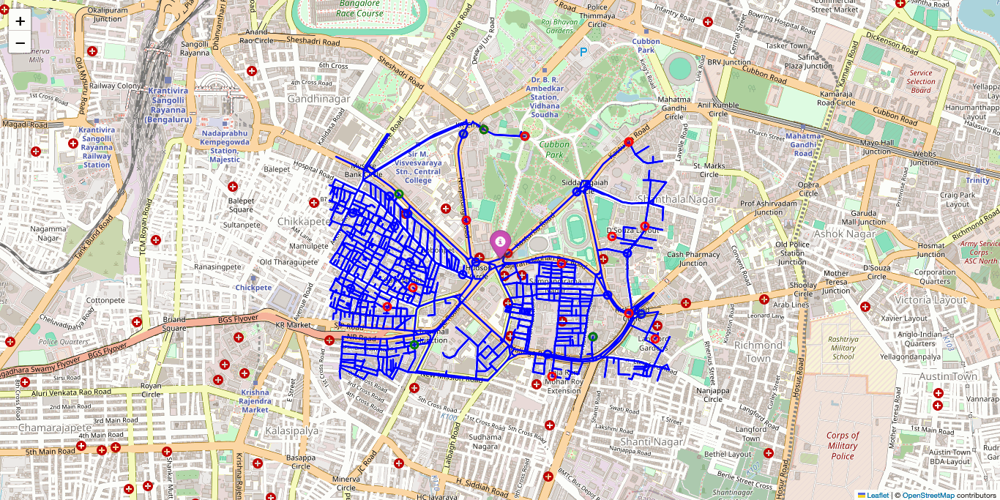

Simulation complete. Check the notebook for the Bangalore traffic congestion animation.


In [1]:
import os
import osmnx as ox
import networkx as nx
import folium
import io
from PIL import Image
from IPython.display import display, Image as IPImage
import mesa
import random

# Bounding box coordinates for Bangalore
north, south, east, west = 12.976, 12.961, 77.599, 77.579  # Adjusted coordinates for Bangalore
bbox = (north, south, east, west)  # Define the bounding box

# Create a graph from the bounding box using the bbox parameter
G = ox.graph_from_bbox(*bbox, network_type='drive')

# Define the TrafficGeoSpace class to integrate with the OSMnx graph
class TrafficGeoSpace(mesa.space.ContinuousSpace):
    def __init__(self, G, crs="EPSG:3857"):
        self.min_x = min(nx.get_node_attributes(G, 'x').values())
        self.max_x = max(nx.get_node_attributes(G, 'x').values())
        self.min_y = min(nx.get_node_attributes(G, 'y').values())
        self.max_y = max(nx.get_node_attributes(G, 'y').values())

        x_max = self.max_x - self.min_x
        y_max = self.max_y - self.min_y
        super().__init__(x_max, y_max, False)
        self.G = G  # Assign the OSMnx graph to the space
        self.crs = crs  # Coordinate Reference System

# Define the VehicleAgent class
class VehicleAgent(mesa.Agent):
    def __init__(self, unique_id, model, vehicle_type, route=None):
        super().__init__(unique_id, model)
        self.vehicle_type = vehicle_type  # Assign vehicle type (car, truck, bike)
        self.route = route  # Assign the route for the vehicle
        self.current_step = 0  # Initialize the current step in the route

    def step(self):
        if self.route and self.current_step < len(self.route):
            next_node = self.route[self.current_step]
            x = self.model.space.G.nodes[next_node]['x'] - self.model.space.min_x
            y = self.model.space.G.nodes[next_node]['y'] - self.model.space.min_y
            self.model.space.move_agent(self, (x, y))
            self.current_step += 1  # Move to the next step in the route
        else:
            pass  # Optionally, handle reaching the end of the route

# Define the TrafficModel class
class TrafficModel(mesa.Model):
    def __init__(self, G, num_vehicles):
        super().__init__()
        self.schedule = mesa.time.RandomActivation(self)
        self.space = TrafficGeoSpace(G)  # No min_x and min_y needed as arguments
        self.create_vehicles(num_vehicles)

    def create_vehicles(self, num_vehicles):
        vehicle_types = ['car', 'truck', 'bike']
        for i in range(num_vehicles):
            start_point = (random.uniform(self.space.min_y, self.space.max_y), random.uniform(self.space.min_x, self.space.max_x))
            end_point = (random.uniform(self.space.min_y, self.space.max_y), random.uniform(self.space.min_x, self.space.max_x))
            start_node = ox.distance.nearest_nodes(self.space.G, X=start_point[1], Y=start_point[0])
            end_node = ox.distance.nearest_nodes(self.space.G, X=end_point[1], Y=end_point[0])

            try:
                route = nx.shortest_path(self.space.G, source=start_node, target=end_node, weight='length')
                vehicle_type = random.choice(vehicle_types)
                vehicle = VehicleAgent(i, self, vehicle_type=vehicle_type, route=route)
                start_position = (self.space.G.nodes[start_node]['x'] - self.space.min_x, 
                                  self.space.G.nodes[start_node]['y'] - self.space.min_y)  # Adjust coordinates
                self.space.place_agent(vehicle, start_position)
                self.schedule.add(vehicle)
            except nx.NetworkXNoPath:
                pass  # Skip this vehicle if no route is found

    def step(self):
        self.schedule.step()

# Running the TrafficModel simulation
num_vehicles = 51
model = TrafficModel(G, num_vehicles)

# Ensure the directory exists
gif_dir = 'Data/'
os.makedirs(gif_dir, exist_ok=True)

# Running the simulation and updating the Folium map
map_images = []
for step in range(10):  # Run for 10 steps
    model.step()

    # Create a new map for each step
    temp_map = folium.Map(location=[(north + south) / 2, (east + west) / 2], zoom_start=15)
    
    # Add the road network to the map
    edges = ox.graph_to_gdfs(G, nodes=False, edges=True)
    for _, row in edges.iterrows():
        points = [(row['geometry'].coords[i][1], row['geometry'].coords[i][0]) for i in range(len(row['geometry'].coords))]
        folium.PolyLine(points, color='blue', weight=2.5, opacity=1).add_to(temp_map)

    # Add vehicles to the map
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            vehicle_position = (vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['y'],
                                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['x'])
            color = 'red' if vehicle.vehicle_type == 'car' else 'blue' if vehicle.vehicle_type == 'truck' else 'green'
            folium.CircleMarker(location=vehicle_position, radius=5, color=color, fill=True).add_to(temp_map)

    # Optionally add markers for significant locations, e.g., SIR MVIT college
    folium.Marker(location=[12.968, 77.589], popup="SIR MVIT College", icon=folium.Icon(color='purple')).add_to(temp_map)

    # Save the map state as an image
    img_data = temp_map._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    map_images.append(img)

# Create an animated GIF from the saved map images
gif_path = os.path.join(gif_dir, 'SMVIT ROAD congestion.gif')
map_images[0].save(gif_path, save_all=True, append_images=map_images[1:], duration=500, loop=0)

# Display the animated GIF in the notebook
display(IPImage(filename=gif_path))

print("Simulation complete. Check the notebook for the Bangalore traffic congestion animation.")


In [20]:
import os
import osmnx as ox
import networkx as nx
import folium
import io
from PIL import Image
from model import TrafficModel, VehicleAgent

# Bounding box coordinates for Bangalore
north, south, east, west = 12.976, 12.961, 77.599, 77.579
bbox = (north, south, east, west)

# Create a graph from the bounding box using the bbox parameter
G = ox.graph_from_bbox(north, south, east, west, network_type='drive')

# Extract graph bounds for the TrafficGeoSpace
min_x = min(nx.get_node_attributes(G, 'x').values())
max_x = max(nx.get_node_attributes(G, 'x').values())
min_y = min(nx.get_node_attributes(G, 'y').values())
max_y = max(nx.get_node_attributes(G, 'y').values())

# Running the TrafficModel simulation
num_vehicles = 51
model = TrafficModel(G, num_vehicles, min_x, min_y, max_x, max_y)

# Ensure the directory exists
gif_dir = 'Data/'
os.makedirs(gif_dir, exist_ok=True)

# Running the simulation and updating the Folium map
map_images = []
for step in range(10):  # Run for 10 steps
    model.step()
    
    # Create a new map for each step
    temp_map = folium.Map(location=[(north + south) / 2, (east + west) / 2], zoom_start=15)
    
    # Add the road network to the map
    edges = ox.graph_to_gdfs(G, nodes=False, edges=True)
    for _, row in edges.iterrows():
        points = [(row['geometry'].coords[i][1], row['geometry'].coords[i][0]) for i in range(len(row['geometry'].coords))]
        folium.PolyLine(points, color='blue', weight=2.5, opacity=1).add_to(temp_map)

    # Add vehicles to the map
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            if vehicle.current_step > 0:
                # Ensure vehicle has moved
                position_node = vehicle.route[vehicle.current_step - 1]
                vehicle_position = (model.space.G.nodes[position_node]['y'],
                                    model.space.G.nodes[position_node]['x'])
                color = 'red' if vehicle.vehicle_type == 'car' else 'blue' if vehicle.vehicle_type == 'truck' else 'green'
                folium.CircleMarker(location=vehicle_position, radius=5, color=color, fill=True).add_to(temp_map)
            else:
                print(f"Vehicle {vehicle.unique_id} has not started its route yet.")

    # Save the map state as an image
    img_data = temp_map._to_png(5)
    img = Image.open(io.BytesIO(img_data))
    map_images.append(img)
    print(f"Step {step} image captured.")

# Create an animated GIF from the saved map images
gif_path = os.path.join(gif_dir, 'bangalore_traffic_congestion.gif')
map_images[0].save(gif_path, save_all=True, append_images=map_images[1:], duration=500, loop=0)

print("Simulation complete. Check the Data/ directory for the Bangalore traffic congestion animation.")


/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_77762/1417358402.py:14: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  G = ox.graph_from_bbox(north, south, east, west, network_type='drive')


TypeError: TrafficModel.__init__() takes 5 positional arguments but 7 were given

In [2]:
!pip install ipyreact

  Obtaining dependency information for ipyreact from https://files.pythonhosted.org/packages/d0/b9/f51936102e7a6469e2883e8f8ff61d33ec8b642bd57e05073305e30d3f83/ipyreact-0.4.1-py3-none-any.whl.metadata
  Obtaining dependency information for anywidget>=0.2.0 from https://files.pythonhosted.org/packages/1a/5a/7b024920cca385eb9b56bc63edf0a647de208346bfac5b339b544733d53a/anywidget-0.9.13-py3-none-any.whl.metadata
  Obtaining dependency information for psygnal>=0.8.1 from https://files.pythonhosted.org/packages/68/76/d5c5bf5a932ec2dcdc4a23565815a1cc5fd96b03b26ff3f647cdff5ea62c/psygnal-0.11.1-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 3.6 MB/s eta 0:00:00a 0:00:010m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.7/213.7 kB 21.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.0/77.0 kB 8.7 MB/s eta 0:00:00


In [6]:
import ipyreact
import pathlib
import numpy as np
import solara
import os
import osmnx as ox
import networkx as nx
import folium
import io
from PIL import Image
from model import TrafficModel, VehicleAgent
# Function to generate random vehicle positions as points
def generate(seed, N):
    np.random.seed(seed)
    mean = [0, 0]  # Mean of the distribution
    cov = [[1, 0], [0, 1]]  # Covariance matrix (identity matrix for simplicity)
    return np.random.multivariate_normal(mean, cov, N)

# Widget class for Voronoi visualization
class VoronoiWidget(ipyreact.ValueWidget):
    _esm = pathlib.Path("voronoi.tsx")

# Reactive states
render_voronoi = solara.reactive(True)
render_delaunay = solara.reactive(True)
seed = solara.reactive(42)
points = solara.reactive(20)

# Voronoi visualization component
@solara.component
def VoronoiPage():
    data = solara.use_memo(lambda: generate(seed.value, points.value), [seed.value, points.value])
    print(data.shape)

    with solara.Column():
        with solara.Row():
            solara.Switch(label="Render delaunay", value=render_delaunay)
            solara.Switch(label="Render voronoi", value=render_voronoi)
        solara.SliderInt(label="points", value=points, min=10, max=500)
    
    VoronoiWidget.element(
        value=data.tolist(),
        props={"width": 600, "height": 400, "render_delaunay": render_delaunay.value, "render_voronoi": render_voronoi.value},
    )


In [7]:
# Function to retrieve vehicle positions from the TrafficModel
def get_vehicle_positions(model):
    positions = []
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            vehicle_position = (
                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['x'],
                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['y']
            )
            positions.append(vehicle_position)
    return np.array(positions)

@solara.component
def VoronoiPage():
    model = TrafficModel(G, num_vehicles)  # Traffic model instance
    
    data = solara.use_memo(lambda: get_vehicle_positions(model), [model.schedule.agents])

    with solara.Column():
        with solara.Row():
            solara.Switch(label="Render delaunay", value=render_delaunay)
            solara.Switch(label="Render voronoi", value=render_voronoi)
        solara.SliderInt(label="points", value=points, min=10, max=500)
    
    VoronoiWidget.element(
        value=data.tolist(),
        props={"width": 600, "height": 400, "render_delaunay": render_delaunay.value, "render_voronoi": render_voronoi.value},
    )

# Running the Voronoi visualization page
VoronoiPage()


Component react.component(__main__.VoronoiPage) raised exception NameError("name 'G' is not defined")
Traceback (most recent call last):
  File "/Users/shikarichacha/anaconda3/lib/python3.11/site-packages/reacton/core.py", line 1707, in _render
    root_element = el.component.f(*el.args, **el.kwargs)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_88741/3152061165.py", line 15, in VoronoiPage
    model = TrafficModel(G, num_vehicles)  # Traffic model instance
                         ^
NameError: name 'G' is not defined


Cannot show ipywidgets in text

In [10]:
import ipyreact
import pathlib
import numpy as np
import solara
import os
import osmnx as ox
import networkx as nx
import folium
import io
from PIL import Image
from model import TrafficModel, VehicleAgent

# Function to generate random vehicle positions as points
def generate(seed, N):
    np.random.seed(seed)
    mean = [0, 0]  # Mean of the distribution
    cov = [[1, 0], [0, 1]]  # Covariance matrix (identity matrix for simplicity)
    return np.random.multivariate_normal(mean, cov, N)

# Widget class for Voronoi visualization
class VoronoiWidget(ipyreact.ValueWidget):
    _esm = pathlib.Path("voronoi.tsx")

# Reactive states
render_voronoi = solara.reactive(True)
render_delaunay = solara.reactive(True)
seed = solara.reactive(42)
points = solara.reactive(20)

# Initialize the graph `G`
# For example, using the graph of Times Square, NYC
location_point = (40.7580, -73.9855)  # Times Square, NYC
G = ox.graph_from_point(location_point, dist=500, network_type='drive')

# Define the number of vehicles
num_vehicles = 10

# Function to retrieve vehicle positions from the TrafficModel
def get_vehicle_positions(model):
    positions = []
    for vehicle in model.schedule.agents:
        if isinstance(vehicle, VehicleAgent):
            vehicle_position = (
                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['x'],
                vehicle.model.space.G.nodes[vehicle.route[vehicle.current_step - 1]]['y']
            )
            positions.append(vehicle_position)
    return np.array(positions)

# Voronoi visualization component
@solara.component
def VoronoiPage():
    model = TrafficModel(G, num_vehicles)  # Traffic model instance
    
    data = solara.use_memo(lambda: get_vehicle_positions(model), [model.schedule.agents])

    with solara.Column():
        with solara.Row():
            solara.Switch(label="Render delaunay", value=render_delaunay)
            solara.Switch(label="Render voronoi", value=render_voronoi)
        solara.SliderInt(label="points", value=points, min=10, max=500)
    
    VoronoiWidget.element(
        value=data.tolist(),
        props={"width": 600, "height": 400, "render_delaunay": render_delaunay.value, "render_voronoi": render_voronoi.value},
    )

# Running the Voronoi visualization page
VoronoiPage()


Component react.component(__main__.VoronoiPage) raised exception TypeError("TrafficModel.__init__() missing 4 required positional arguments: 'min_x', 'min_y', 'max_x', and 'max_y'")
Traceback (most recent call last):
  File "/Users/shikarichacha/anaconda3/lib/python3.11/site-packages/reacton/core.py", line 1707, in _render
    root_element = el.component.f(*el.args, **el.kwargs)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/qh/215l544s06x3_jp987f9gdgh0000gn/T/ipykernel_88741/1519825377.py", line 53, in VoronoiPage
    model = TrafficModel(G, num_vehicles)  # Traffic model instance
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
TypeError: TrafficModel.__init__() missing 4 required positional arguments: 'min_x', 'min_y', 'max_x', and 'max_y'


Cannot show ipywidgets in text